This notebook takes brain voxels and maps them to CLIP-space via a contrastive learning to CLIP space + diffusion prior approach.

In [1]:
# # convert this notebook to .py such that you can then run it via slurm with "sbatch *.slurm"
# from subprocess import call
# command = "jupyter nbconvert Brain_to_Image.ipynb --to python"
# call(command,shell=True)

[NbConvertApp] Converting notebook Brain_to_Image.ipynb to python
[NbConvertApp] Writing 26859 bytes to Brain_to_Image.py


0

# Import packages & functions

In [2]:
import os
import sys
import json
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.distributed as dist
from torch.nn.parallel import DistributedDataParallel as DDP
from torchvision import transforms
from info_nce import InfoNCE
from tqdm import tqdm
from collections import OrderedDict
from dalle2_pytorch import DiffusionPriorNetwork

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("device:",device)

import ddp_config
distributed,local_rank = ddp_config.ddp_test()
if device=='cuda': torch.cuda.set_device(local_rank)

import utils
from utils import torch_to_matplotlib, torch_to_Image
from models import Clipper, BrainNetwork, BrainDiffusionPrior
from model3d import NewVoxel3dConvEncoder

num_devices = torch.cuda.device_count()
if num_devices==0: num_devices = 1
num_workers = num_devices

device: cuda
NOT using distributed parallel processing!


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


# Configurations

In [3]:
model_name = "prior-w-voxel2clip"
modality = "image" # ("image", "text")
image_var = 'images' if modality=='image' else trial
clip_variant = "ViT-L/14" # ("RN50", "ViT-L/14", "ViT-B/32")
clamp_embs = False # clamp embeddings to (-1.5, 1.5)
recon_timesteps = 1000 # for diffusion prior, should be 1000 if using conditioned_prior (which we are)
alpha_schedule = "constant" # ("constant", "linear") - for weighting the loss
voxel2clip_kwargs = dict(out_dim=768)
voxel_dims = 1 # 1 for flattened input, 3 for 3d input
n_samples_save = 4 # how many SD reconstruction samples from train and val to save to monitor progress
num_inference_steps = 50 # how many steps for diffusion model to output pixel image reconstruction
img2img_strength = .6 # closer to 0 the more the recon will look like the input image 
recons_per_clip = 2
recons_per_brain = 4

num_samples = None #if None, using total num of training samples specified in webdataset metadata.json
batch_size = 64 #300
num_epochs = 20
lr_scheduler = 'cycle'
initial_lr = 1e-3
max_lr = 3e-4
ckpt_saving = True
ckpt_interval = 2
save_at_end = False
seed = 42
outdir = f'../train_logs/models/{model_name}/test'
if not os.path.exists(outdir):
    os.makedirs(outdir)
use_mp = False

# params for data
remote_data = False # pull data from huggingface if True
data_commit = '9947586218b6b7c8cab804009ddca5045249a38d' # only applies when remote_data=True
cache_dir = "/tmp/wds-cache"
n_cache_recs = 0

# params for wandb
wandb_log = True
wandb_project = 'stability'
wandb_run = 'full'
wandb_notes = ''

# if running command line, read in args or config file values and override above params
try:
    config_keys = [k for k,v in globals().items() if not k.startswith('_') \
                   and isinstance(v, (int, float, bool, str))]
    exec(open('configurator.py').read()) # overrides from command line or config file
    config = {k: globals()[k] for k in config_keys} # will be useful for logging
except:
    print("skipping configurator override...")
    pass

if wandb_log and local_rank==0: 
    import wandb
    print(f"wandb {wandb_project} run {wandb_run}")
    wandb.login(host='https://stability.wandb.io')#, relogin=True)
    wandb_config = {
      "model_name": model_name,
      "modality": modality,
      "clip_variant": clip_variant,
      "batch_size": batch_size,
      "num_epochs": num_epochs,
      "initial_lr": initial_lr,
      "max_lr": max_lr,
      "lr_scheduler": lr_scheduler,
      "alpha_schedule": alpha_schedule,
      "clamp_embs": clamp_embs,
    }
    wandb.init(
        project=wandb_project,
        name=wandb_run,
        config=wandb_config,
        notes=wandb_notes,
    )

Overriding config with -f:
skipping configurator override...
wandb stability run full


wandb: Currently logged in as: paulscotti. Use `wandb login --relogin` to force relogin


# Prep models and data loaders

In [4]:
if local_rank == 0: print('Creating Clipper...')
    
# Don't L2 norm the extracted CLIP embeddings since we want the prior 
# to learn un-normed embeddings for usage with the SD image variation pipeline.
clip_extractor = Clipper(clip_variant, clamp_embs=clamp_embs, norm_embs=False, device=device)

if local_rank == 0: print('Creating voxel2clip...')

if voxel_dims == 1: # 1D data
    voxel2clip = BrainNetwork(**voxel2clip_kwargs)
    # 134M params
elif voxel_dims == 3: # 3D data
    voxel2clip = NewVoxel3dConvEncoder(**voxel2clip_kwargs)
    # 58M params for original version
    # 5M params for smaller version
    # Projection input features: 5120
    # param counts:
    # 5,584,448 total
    # 5,584,448 trainable
    
try:
    utils.count_params(voxel2clip)
except:
    if local_rank == 0: print('Cannot count params for voxel2clip (probably because it has Lazy layers)')

if local_rank == 0: print('Creating diffusion prior...')

# initializing diffusion prior with https://huggingface.co/nousr/conditioned-prior
assert recon_timesteps == 1000
diffusion_prior = BrainDiffusionPrior.from_pretrained(
    # kwargs for DiffusionPriorNetwork
    dict(),
    # kwargs for DiffusionNetwork
    dict(
        condition_on_text_encodings=False,
        timesteps=recon_timesteps,
        # cond_drop_prob=cond_drop_prob,
        # image_embed_scale=image_embed_scale,
        voxel2clip=voxel2clip,
    ),
)

if distributed:
    diffusion_prior = diffusion_prior.to(local_rank)
    diffusion_prior = DDP(diffusion_prior, device_ids=[local_rank])
else:
    diffusion_prior = diffusion_prior.to(device)
try:
    utils.count_params(diffusion_prior)
except:
    if local_rank == 0: print('Cannot count params for diffusion_prior (probably because it has Lazy layers)')

if local_rank == 0: print('Creating SD image variation pipeline...')
from diffusers import StableDiffusionImageVariationPipeline
from diffusers import AutoencoderKL, PNDMScheduler, UNet2DConditionModel
from transformers import CLIPVisionModelWithProjection, CLIPFeatureExtractor

sd_cache_dir = '/fsx/home-paulscotti/.cache/huggingface/diffusers/models--lambdalabs--sd-image-variations-diffusers/snapshots/a2a13984e57db80adcc9e3f85d568dcccb9b29fc'
if not os.path.isdir(sd_cache_dir): # download from huggingface if not already downloaded / cached
    print("Downloading lambdalabs/sd-image-variations-diffusers from huggingface...")
    sd_pipe = StableDiffusionImageVariationPipeline.from_pretrained("lambdalabs/sd-image-variations-diffusers", revision="v2.0")
    sd_cache_dir = "lambdalabs/sd-image-variations-diffusers"

unet = UNet2DConditionModel.from_pretrained(sd_cache_dir,subfolder="unet").to(device)
vae = AutoencoderKL.from_pretrained(sd_cache_dir,subfolder="vae").to(device)
# image_encoder = CLIPVisionModelWithProjection.from_pretrained(sd_cache_dir,subfolder="image_encoder").to(device)
noise_scheduler = PNDMScheduler.from_pretrained(sd_cache_dir, subfolder="scheduler")

unet.eval() # dont want to train model
unet.requires_grad_(False) # dont need to calculate gradients

vae.eval()
vae.requires_grad_(False)

# image_encoder.eval()
# image_encoder.requires_grad_(False)
# assert image_encoder.training == False

if local_rank == 0: print('Pulling NSD webdataset data...')
if remote_data:
    # pull data directly from huggingface
    train_url, val_url = utils.get_huggingface_urls(data_commit)
    meta_url = None
else:
    # local paths
    # train_url = "/scratch/gpfs/KNORMAN/webdataset_nsd/webdataset_split/train/train_subj01_{0..49}.tar"
    # val_url = "/scratch/gpfs/KNORMAN/webdataset_nsd/webdataset_split/val/val_subj01_0.tar"
    # meta_url = None
    
    train_url = "/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset/train/train_subj01_{0..49}.tar"
    val_url = "/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset/val/val_subj01_0.tar"
    meta_url = "/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset/metadata_subj01.json"

# which to use for the voxels
if voxel_dims == 1:
    voxels_key = 'nsdgeneral.npy'
elif voxel_dims == 3:
    voxels_key = 'wholebrain_3d.npy'
else:
    raise Exception(f"voxel_dims must be 1 or 3, not {voxel_dims}")

if local_rank == 0: print('Prepping train and validation dataloaders...')
train_dl, val_dl, num_train, num_val = utils.get_dataloaders(
    batch_size, image_var,
    num_workers=num_workers,
    train_url=train_url,
    val_url=val_url,
    meta_url=meta_url,
    num_samples=num_samples,
    cache_dir=cache_dir,
    n_cache_recs=n_cache_recs,
    voxels_key=voxels_key,
)

optimizer = torch.optim.AdamW(diffusion_prior.parameters(), lr=initial_lr)
if lr_scheduler == 'fixed':
    lr_scheduler = None
elif lr_scheduler == 'cycle':
    # <TODO> hard-coded values
    lr_scheduler = torch.optim.lr_scheduler.OneCycleLR(
        optimizer, 
        max_lr=max_lr, 
        total_steps=num_epochs*((num_train//batch_size)//num_devices), 
        final_div_factor=1000,
        last_epoch=-1, pct_start=2/num_epochs
    )
    
def save_ckpt(tag):
    ckpt_path = os.path.join(outdir, f'ckpt-{tag}.pth')
    print(f'saving {ckpt_path}',flush=True)
    if local_rank==0:
        state_dict = diffusion_prior.state_dict()
        if distributed: # if using DDP, convert DDP state_dict to non-DDP before saving
            for key in list(state_dict.keys()):
                if 'module.' in key:
                    state_dict[key.replace('module.', '')] = state_dict[key]
                    del state_dict[key]
        torch.save({
            'epoch': epoch,
            'model_state_dict': diffusion_prior.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'train_losses': losses,
            'val_losses': val_losses,
            'lrs': lrs,
            }, ckpt_path)

        # if wandb_log:
        #     wandb.save(ckpt_path)
print("\nDone with model preparations!")

Creating Clipper...
ViT-L/14 cuda
Creating voxel2clip...
param counts:
134,722,304 total
134,722,304 trainable
Creating diffusion prior...
param counts:
236,616,336 total
236,616,320 trainable
Creating SD image variation pipeline...
Pulling NSD webdataset data...
Prepping train and validation dataloaders...
Getting dataloaders...
train_url /fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset/train/train_subj01_{0..49}.tar
val_url /fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset/val/val_subj01_0.tar
num_devices 1
num_workers 1
batch_size 64
global_batch_size 64
num_worker_batches 424
num_train 27150
num_val 300
cache_dir None
validation: num_worker_batches 5

Done with model preparations!


# Main

Note: not using cudnn.deterministic


  0%|                                                                                                                                                                                                                              | 0/20 [00:00<?, ?it/s]

voxel0.shape torch.Size([64, 15724])


  0%|                                                                                                                                                  | 0/20 [03:49<?, ?it/s, lr=0.000156, train_loss=5.89, train_sim=0.608, val_loss=5.2, val_sim=0.572]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth


  5%|██████▊                                                                                                                                 | 1/20 [07:39<1:14:01, 233.77s/it, lr=0.0003, train_loss=4.16, train_sim=0.686, val_loss=4.03, val_sim=0.765]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch001.pth


 10%|█████████████▍                                                                                                                        | 2/20 [14:09<1:37:48, 326.03s/it, lr=0.000298, train_loss=3.05, train_sim=0.826, val_loss=3.33, val_sim=0.848]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth


 15%|████████████████████                                                                                                                  | 3/20 [17:59<1:19:55, 282.06s/it, lr=0.000291, train_loss=2.32, train_sim=0.878, val_loss=3.03, val_sim=0.884]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch003.pth


 20%|███████████████████████████                                                                                                            | 4/20 [24:27<1:26:33, 324.62s/it, lr=0.00028, train_loss=1.93, train_sim=0.909, val_loss=2.78, val_sim=0.911]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth


 25%|█████████████████████████████████▊                                                                                                     | 5/20 [28:18<1:12:30, 290.00s/it, lr=0.000265, train_loss=1.57, train_sim=0.929, val_loss=2.7, val_sim=0.926]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch005.pth


 30%|████████████████████████████████████████▏                                                                                             | 6/20 [34:46<1:15:31, 323.70s/it, lr=0.000246, train_loss=1.34, train_sim=0.943, val_loss=2.63, val_sim=0.936]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth


 35%|██████████████████████████████████████████████▉                                                                                       | 7/20 [38:36<1:03:28, 292.94s/it, lr=0.000225, train_loss=1.12, train_sim=0.954, val_loss=2.56, val_sim=0.946]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch007.pth


 40%|█████████████████████████████████████████████████████▏                                                                               | 8/20 [45:03<1:04:27, 322.28s/it, lr=0.000201, train_loss=0.973, train_sim=0.961, val_loss=2.49, val_sim=0.955]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth


 45%|████████████████████████████████████████████████████████████▊                                                                          | 9/20 [48:53<53:52, 293.87s/it, lr=0.000176, train_loss=0.826, train_sim=0.967, val_loss=2.47, val_sim=0.961]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch009.pth


 50%|███████████████████████████████████████████████████████████████████▌                                                                   | 10/20 [55:21<53:51, 323.19s/it, lr=0.00015, train_loss=0.764, train_sim=0.971, val_loss=2.45, val_sim=0.962]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth


 55%|█████████████████████████████████████████████████████████████████████████▋                                                            | 11/20 [59:15<44:11, 294.62s/it, lr=0.000124, train_loss=0.659, train_sim=0.974, val_loss=2.45, val_sim=0.963]

not best - val_loss: 2.452, best_val_loss: 2.450
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch011.pth


 60%|███████████████████████████████████████████████████████████████████████████████▊                                                     | 12/20 [1:05:49<43:21, 325.22s/it, lr=9.87e-5, train_loss=0.616, train_sim=0.976, val_loss=2.44, val_sim=0.969]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth


 65%|███████████████████████████████████████████████████████████████████████████████████████                                               | 13/20 [1:09:39<34:39, 297.08s/it, lr=7.5e-5, train_loss=0.553, train_sim=0.978, val_loss=2.42, val_sim=0.967]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch013.pth


 70%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 14/20 [1:16:12<32:35, 325.87s/it, lr=5.36e-5, train_loss=0.532, train_sim=0.98, val_loss=2.36, val_sim=0.969]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 15/20 [1:20:02<24:45, 297.11s/it, lr=3.51e-5, train_loss=0.492, train_sim=0.981, val_loss=2.35, val_sim=0.971]

saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-best.pth
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch015.pth


 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 17/20 [1:26:27<14:41, 293.97s/it, lr=2.01e-5, train_loss=0.481, train_sim=0.981, val_loss=2.38, val_sim=0.975]

not best - val_loss: 2.382, best_val_loss: 2.351


 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 17/20 [1:30:12<14:41, 293.97s/it, lr=9.06e-6, train_loss=0.478, train_sim=0.982, val_loss=2.36, val_sim=0.971]

not best - val_loss: 2.359, best_val_loss: 2.351
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch017.pth


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 19/20 [1:36:43<04:54, 294.29s/it, lr=2.29e-6, train_loss=0.463, train_sim=0.982, val_loss=2.41, val_sim=0.97]

not best - val_loss: 2.406, best_val_loss: 2.351


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 19/20 [1:40:31<04:54, 294.29s/it, lr=1.2e-8, train_loss=0.47, train_sim=0.982, val_loss=2.37, val_sim=0.973]

not best - val_loss: 2.373, best_val_loss: 2.351
saving ../train_logs/models/prior-w-voxel2clip/test/ckpt-epoch019.pth


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [1:43:11<00:00, 309.58s/it, lr=1.2e-8, train_loss=0.47, train_sim=0.982, val_loss=2.37, val_sim=0.973]


train/alpha,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train/bwd_pct_correct,▁▃▄▅▆▇▇▇████████████
train/cosine_sim,▁▂▅▆▇▇▇▇████████████
train/cosine_sim_base,▁▃▄▄▅▅▆▆▆▇▇▇▇███████
train/fwd_pct_correct,▁▄▅▆▇▇██████████████
train/loss,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
train/loss_nce,█▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
train/loss_prior,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
train/lr,▅████▇▇▆▆▅▄▄▃▃▂▂▁▁▁▁
train/num_steps,▁▁▂▂▂▃▃▄▄▄▅▅▅▆▆▇▇▇██
val/cosine_sim,▁▄▆▆▇▇▇▇████████████


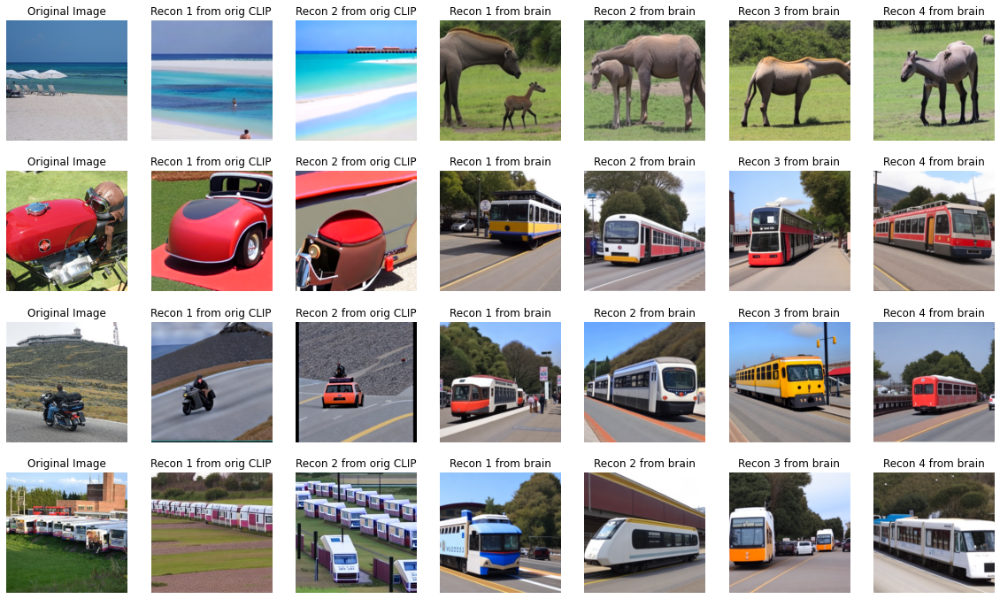

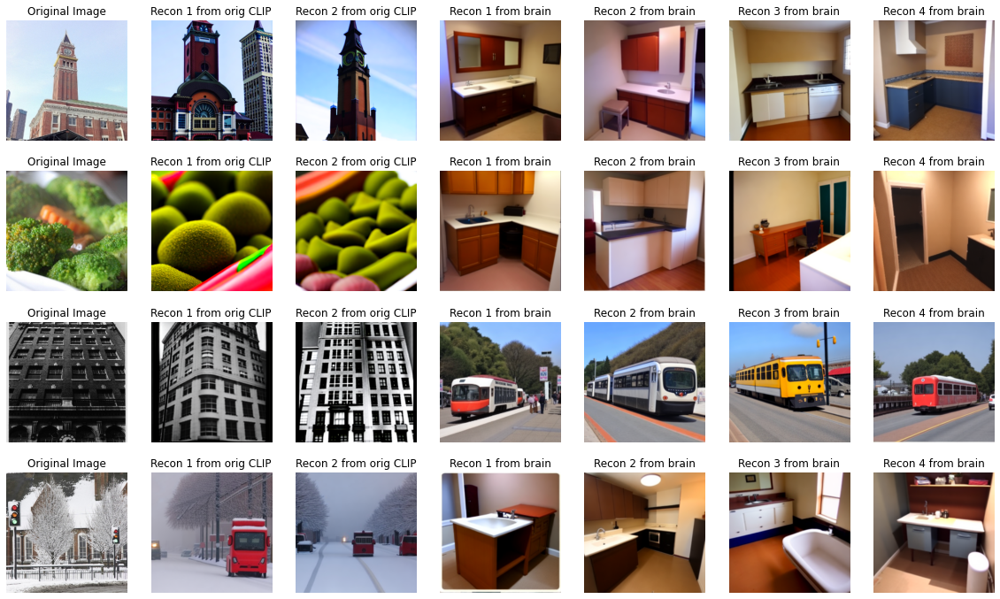

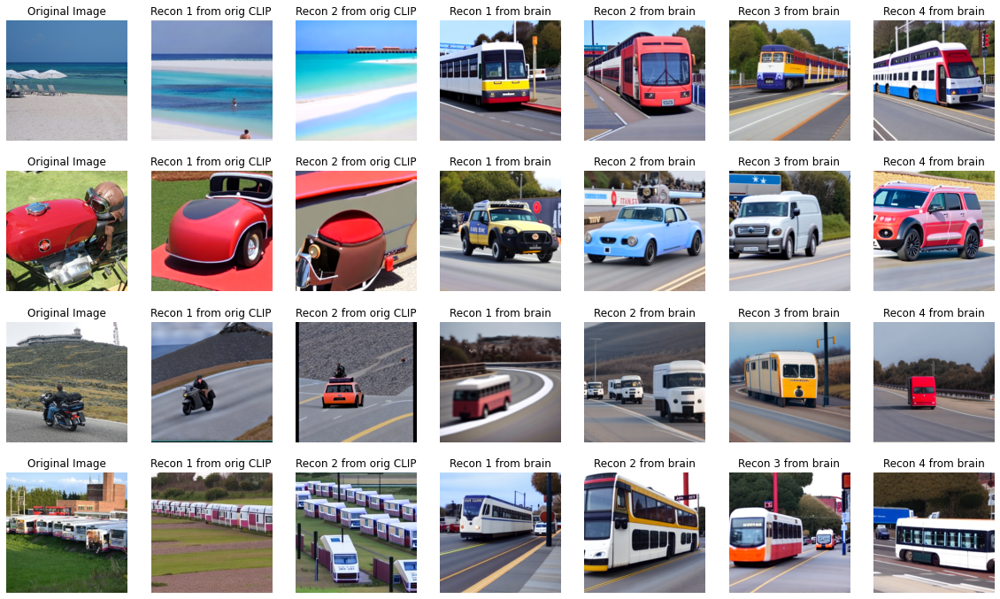

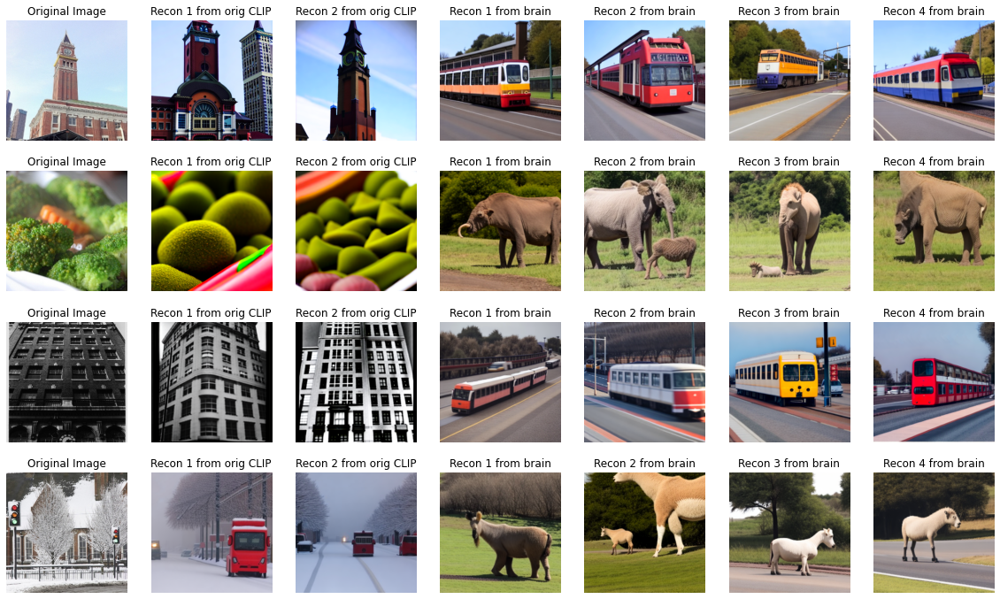

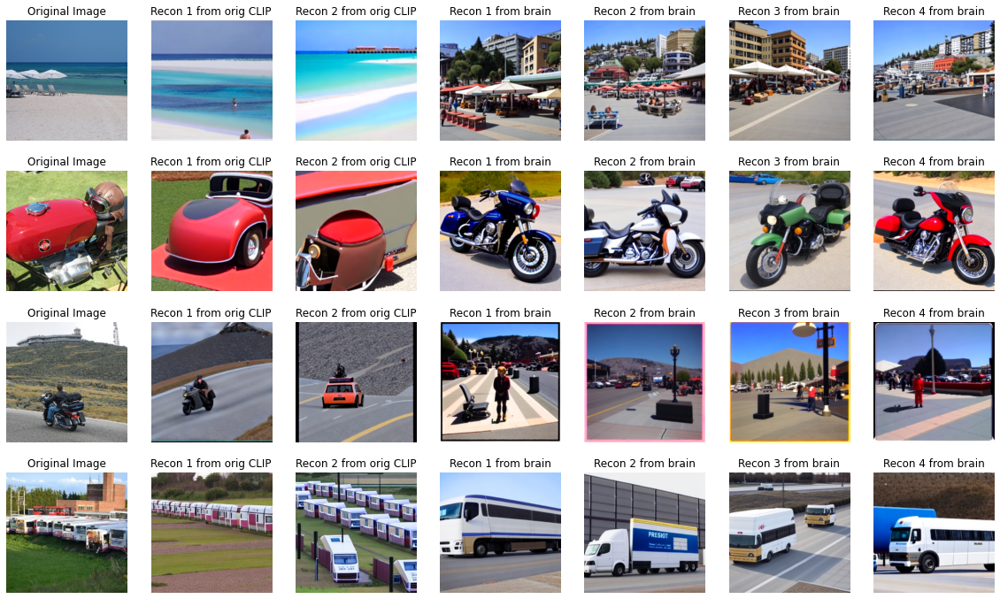

...

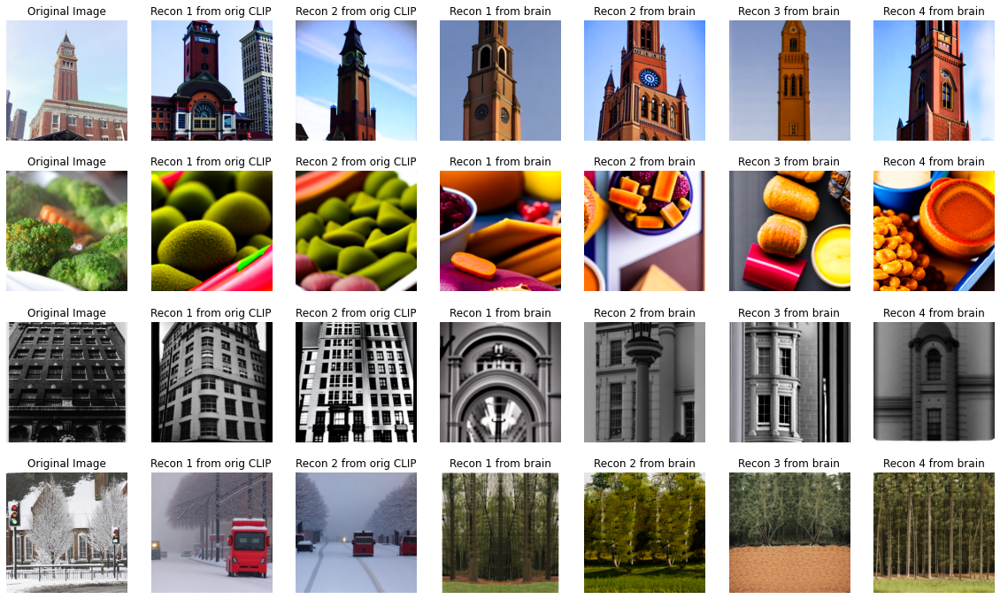

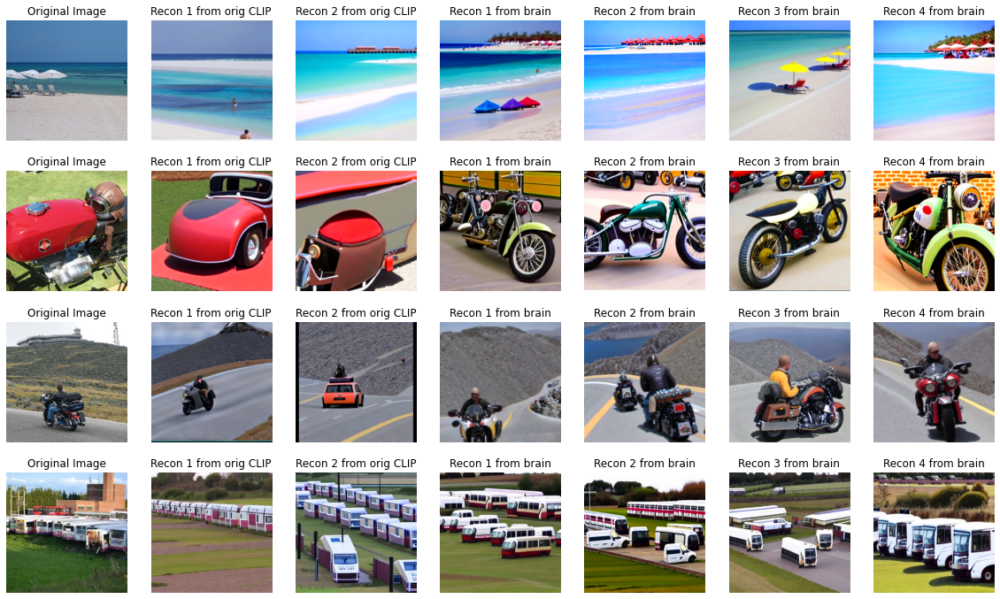

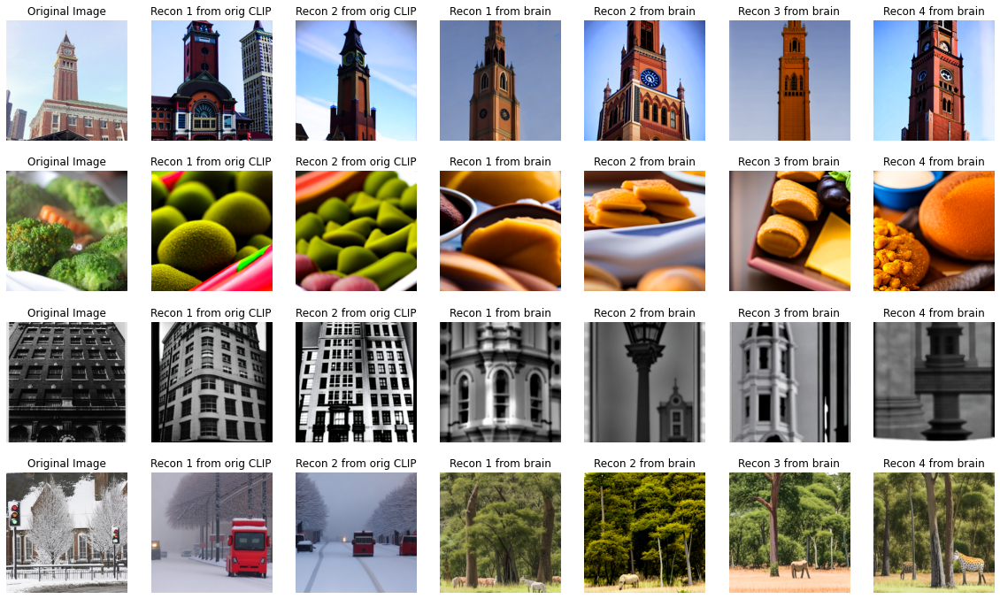

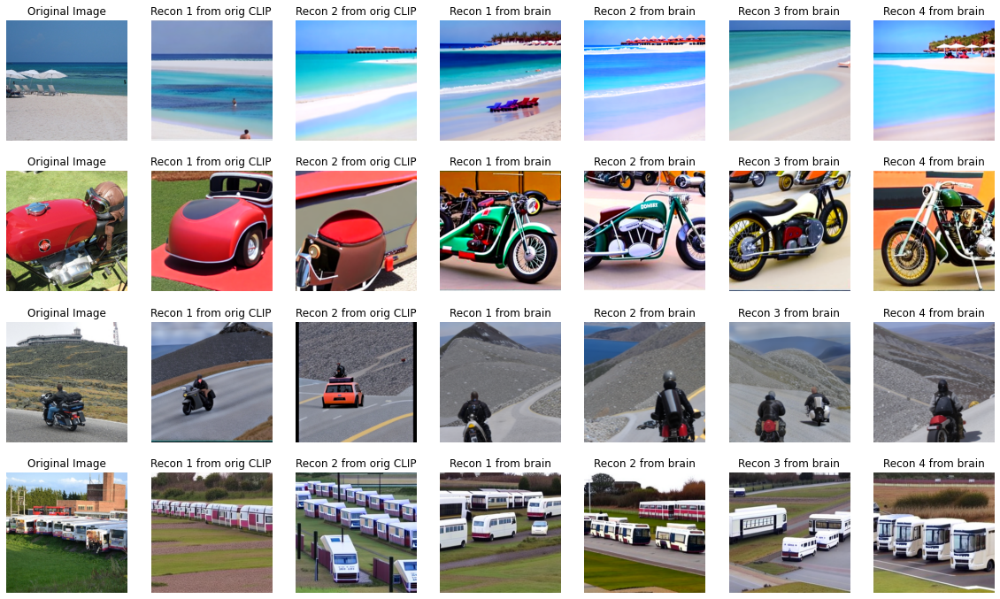

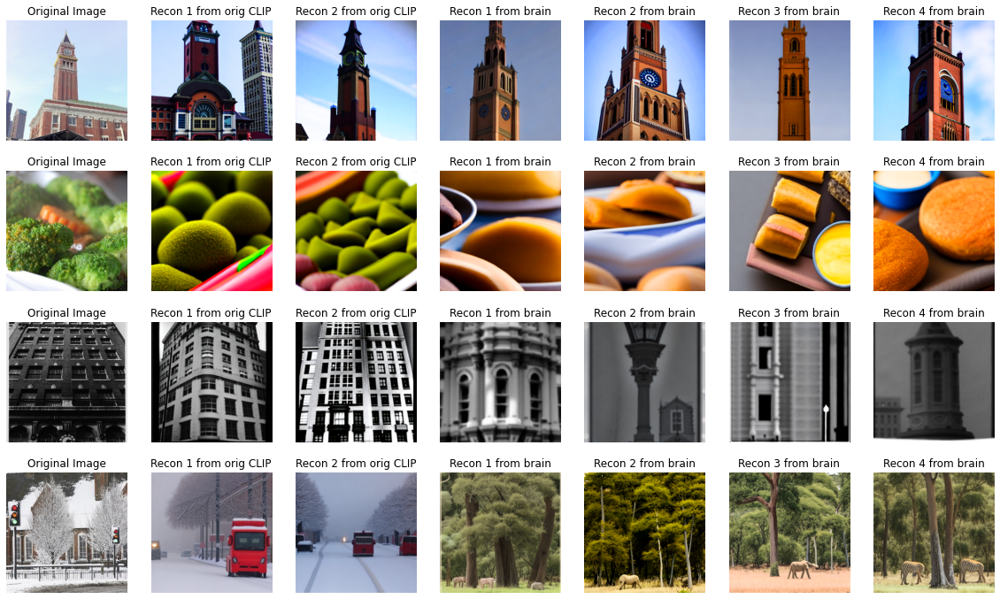

In [4]:
# need non-deterministic CuDNN for conv3D to work
utils.seed_everything(local_rank, cudnn_deterministic=False)

epoch = 0
losses, val_losses, lrs = [], [], []
best_val_loss = 1e9
nce = utils.mixco_nce  # same as infonce if mixup not used

# weight for prior's MSE loss term
if alpha_schedule == 'constant':
    alphas = np.ones(num_epochs) * 0.01
elif alpha_schedule == 'linear':
    alphas = np.linspace(0.01, 0.05, num_epochs, endpoint=True)
else:
    raise ValueError(f'unknown alpha_schedule: {alpha_schedule}')

voxel0 = image0 = val_voxel0 = val_image0 = None

progress_bar = tqdm(range(epoch,num_epochs), ncols=250, disable=(local_rank!=0))
for epoch in progress_bar:
    diffusion_prior.train()

    sims = 0.
    sims_base = 0.
    val_sims = 0.
    val_sims_base = 0.
    fwd_percent_correct = 0.
    bwd_percent_correct = 0.
    val_fwd_percent_correct = 0.
    val_bwd_percent_correct = 0.
    loss_nce_sum = 0.
    loss_prior_sum = 0.
    val_loss_nce_sum = 0.
    val_loss_prior_sum = 0.

    alpha = alphas[epoch]

    for train_i, (voxel, image, key) in enumerate(train_dl):
        optimizer.zero_grad()

        image = image.to(device).float()
        voxel = voxel.to(device).float()
        if image0 is None and local_rank == 0:
            image0 = image.clone()
            voxel0 = voxel.clone()
            key0 = key # key acts as dictionary lookup to the original sample#.png 
            print("voxel0.shape",voxel0.shape)

        with torch.cuda.amp.autocast(enabled=use_mp):
            with torch.cuda.amp.autocast(enabled=True):
                clip_image = clip_extractor.embed_image(image, return_norm=False).float()
            loss, pred, clip_voxels = diffusion_prior(image_embed=clip_image, voxel=voxel)
            utils.check_loss(loss)

            loss_nce = nce(
                nn.functional.normalize(clip_voxels, dim=-1), 
                nn.functional.normalize(clip_image, dim=-1),
                distributed=distributed
            )
            utils.check_loss(loss_nce)

            loss_nce_sum += loss_nce.item()
            loss_prior_sum += loss.item()

            # MSE and NCE are weighted equally at the beginning,
            # with alpha=0.01 we'll have something like .01*300 + .99*3 = 3 + 3
            loss = alpha * loss + (1-alpha) * loss_nce

            losses.append(loss.item())
            lrs.append(optimizer.param_groups[0]['lr'])
            # similarity after prior diffusion
            sims += F.cosine_similarity(clip_image, pred).mean().item()
            # baseline similarity before prior diffusion
            sims_base += F.cosine_similarity(clip_image, clip_voxels).mean().item()
            # forward and backward top 1 accuracy
            labels = torch.arange(len(clip_voxels)).to(device)
            fwd_percent_correct += utils.topk(
                utils.batchwise_cosine_similarity(clip_image, clip_voxels), labels, k=1
            )
            bwd_percent_correct += utils.topk(
                utils.batchwise_cosine_similarity(clip_voxels, clip_image), labels, k=1
            )

        loss.backward()
        optimizer.step()

        if lr_scheduler is not None:
            lr_scheduler.step()

    if local_rank==0: 
        diffusion_prior.eval()
        for val_i, (voxel, image, key) in enumerate(val_dl): 
            with torch.no_grad():
                image = image.to(device).float()
                voxel = voxel.to(device).float()
                if val_image0 is None:
                    val_image0 = image.clone()
                    val_voxel0 = voxel.clone()
                    val_key0 = key

                with torch.cuda.amp.autocast():
                    clip_image = clip_extractor.embed_image(image).float()
                    if distributed:
                        loss, pred, clip_voxels = diffusion_prior.module(image_embed=clip_image, voxel=voxel)
                    else:
                        loss, pred, clip_voxels = diffusion_prior(image_embed=clip_image, voxel=voxel)

                    loss_nce = nce(
                        nn.functional.normalize(clip_voxels, dim=-1), 
                        nn.functional.normalize(clip_image, dim=-1),
                    )
                    utils.check_loss(loss_nce)

                    val_loss_nce_sum += loss_nce.item()
                    val_loss_prior_sum += loss.item()

                    val_loss = alpha * loss + (1-alpha) * loss_nce

                    val_losses.append(val_loss.item())
                    val_sims += F.cosine_similarity(clip_image, pred).mean().item()
                    val_sims_base += F.cosine_similarity(clip_image, clip_voxels).mean().item()
                    labels = torch.arange(len(clip_voxels)).to(device)
                    val_fwd_percent_correct += utils.topk(
                        utils.batchwise_cosine_similarity(clip_image, clip_voxels), labels, k=1
                    )
                    val_bwd_percent_correct += utils.topk(
                        utils.batchwise_cosine_similarity(clip_voxels, clip_image), labels, k=1
                    )

        logs = OrderedDict(
            train_loss=np.mean(losses[-(train_i+1):]),
            val_loss=np.mean(val_losses[-(val_i+1):]),
            lr=lrs[-1],
            train_sim=sims / (train_i + 1),
            val_sim=val_sims / (val_i + 1),
        )
        progress_bar.set_postfix(**logs)

        if (not save_at_end and ckpt_saving) or (save_at_end and epoch == num_epochs - 1):
            # save best model
            val_loss = np.mean(val_losses[-(val_i+1):])
            if val_loss < best_val_loss:
                best_val_loss = val_loss
                save_ckpt('best')
            else:
                print(f'not best - val_loss: {val_loss:.3f}, best_val_loss: {best_val_loss:.3f}')

            # Save model checkpoint every `ckpt_interval`` epochs or on the last epoch
            if (ckpt_interval is not None and (epoch + 1) % ckpt_interval == 0) or epoch == num_epochs - 1:
                save_ckpt(f'epoch{epoch:03d}')

        logs = {
            "train/loss": np.mean(losses[-(train_i+1):]),
            "val/loss": np.mean(val_losses[-(val_i+1):]),
            "train/lr": lrs[-1],
            "train/num_steps": len(losses),
            "train/cosine_sim": sims / (train_i + 1),
            "val/cosine_sim": val_sims / (val_i + 1),
            "train/cosine_sim_base": sims_base / (train_i + 1),
            "val/cosine_sim_base": val_sims_base / (val_i + 1),
            "train/fwd_pct_correct": fwd_percent_correct / (train_i + 1),
            "train/bwd_pct_correct": bwd_percent_correct / (train_i + 1),
            "val/val_fwd_pct_correct": val_fwd_percent_correct / (val_i + 1),
            "val/val_bwd_pct_correct": val_bwd_percent_correct / (val_i + 1),
            "train/loss_nce": loss_nce_sum / (train_i + 1),
            "train/loss_prior": loss_prior_sum / (train_i + 1),
            "val/loss_nce": val_loss_nce_sum / (val_i + 1),
            "val/loss_prior": val_loss_prior_sum / (val_i + 1),
            "train/alpha": alpha,
        }

        # sample some images
        if (ckpt_interval is not None and (epoch + 1) % ckpt_interval == 0) or epoch == num_epochs - 1:
            if (not save_at_end and n_samples_save > 0) or (save_at_end and epoch == num_epochs - 1):
                # training   
                grid = utils.reconstruct_from_clip(
                    image0, voxel0,
                    diffusion_prior,
                    clip_extractor, unet, vae, noise_scheduler,
                    img_lowlevel = None,
                    num_inference_steps = num_inference_steps,
                    n_samples_save = n_samples_save,
                    recons_per_clip = recons_per_clip,
                    recons_per_brain = recons_per_brain,
                    guidance_scale = 7.5,
                    img2img_strength = img2img_strength,
                    timesteps = recon_timesteps,
                    seed = seed,
                    distributed = distributed,
                )
                grid.savefig(os.path.join(outdir, f'samples-train-epoch{epoch:03d}.png'))
                if wandb_log and local_rank==0:
                    logs[f"train/recons"] = wandb.Image(grid, caption=f"epoch{epoch:03d}")

                # validation
                grid = utils.reconstruct_from_clip(
                    val_image0, val_voxel0,
                    diffusion_prior, 
                    clip_extractor, unet, vae, noise_scheduler,
                    img_lowlevel = None,
                    num_inference_steps = num_inference_steps,
                    n_samples_save = n_samples_save,
                    recons_per_clip = recons_per_clip,
                    recons_per_brain = recons_per_brain,
                    guidance_scale = 7.5,
                    img2img_strength = img2img_strength,
                    timesteps = recon_timesteps,
                    seed = seed,
                    distributed = distributed,
                )
                grid.savefig(os.path.join(outdir, f'samples-val-epoch{epoch:03d}.png'))
                if wandb_log and local_rank==0:
                    logs[f"val/recons"] = wandb.Image(grid, caption=f"epoch{epoch:03d}")

        if wandb_log and local_rank==0:
            wandb.log(logs)
    if distributed:
        dist.barrier()

if wandb_log and local_rank==0:
    wandb.finish()

# Debugging cells below
Make sure to comment out all the cells below if converting to .py

In [17]:
# from torchmetrics.image.fid import FrechetInceptionDistance

# def null_sync(t, *args, **kwargs):
#     return [t]

# def convert_imgs_for_fid(imgs):
#     # Convert from [0, 1] to [0, 255] and from torch.float to torch.uint8
#     return imgs.mul(255).add(0.5).clamp(0, 255).type(torch.uint8)

# fid = FrechetInceptionDistance(feature=64, dist_sync_fn=null_sync).to(device)

# # inside FID it will resize to 300x300 from 256x256
# # [n, 3, 256, 256]
# # print('img_input.shape', img_input.shape)
# fid.update(convert_imgs_for_fid(img_input.to(device)), real=True)

# # inside FID it will resize to 300x300 from 512x512
# print('Done sampling images, updating FID', flush=True)

# img_blur = transforms.functional.gaussian_blur(image0,kernel_size=9)
# fid.update(convert_imgs_for_fid(img_blur.to(device)), real=False)
# print('Done updating FID', flush=True)
# fid.compute().item()

Done sampling images, updating FID
Done updating FID


18.7346134185791

In [ ]:
# n_samples_save=4
# for train_i, (voxel0, image0) in enumerate(train_dl):
#     if train_i==0:
#         voxel=voxel0[:n_samples_save].to(device)
#         image=image0[:n_samples_save].to(device)
#         #img_lowlevel=image0[:n_samples_save].to(device)
#     else:
#         break

# for i in range(image.shape[0]):
#     plt.imshow(torch_to_matplotlib(image[i].unsqueeze(0)))
#     plt.show()

In [ ]:
# generator = torch.Generator(device=device)
# generator.manual_seed(seed)

# image_embeddings = clip_extractor.embed_image(image).float()

# # Encode voxels to CLIP space
# # diffusion_prior.voxel2clip.eval()
# # image_embeddings = diffusion_prior.voxel2clip(voxel[:1].to(device).float())

# # # NOTE: requires fork of DALLE-pytorch for generator arg
# # image_embeddings = diffusion_prior.p_sample_loop(image_embeddings.shape, 
# #                                     text_cond = dict(text_embed = image_embeddings), 
# #                                     cond_scale = 1., timesteps = timesteps, #1000 timesteps used from nousr pretraining
# #                                     generator=generator
# #                                     )

# # duplicate the embedding to serve classifier free guidance
# num_per_sample = 4 # how many reconstruction attempts per image input
# image_embeddings = image_embeddings.repeat(num_per_sample, 1)
# image_embeddings = torch.cat([torch.zeros_like(image_embeddings), image_embeddings]).unsqueeze(1).to(device)
# image_embeddings.shape

In [ ]:
# guidance_scale = 7.5
# do_classifier_free_guidance = guidance_scale > 1.0
# batch_size = image_embeddings.shape[0] // 2 # divide by 2 bc you doubled it for classifier-free guidance
# vae_scale_factor = 2 ** (len(vae.config.block_out_channels) - 1)
# height = unet.config.sample_size * vae_scale_factor
# width = unet.config.sample_size * vae_scale_factor

# # 4. Prepare timesteps
# noise_scheduler.set_timesteps(num_inference_steps, device=device)

# # 5b. Prepare latent variables
# shape = (batch_size, unet.in_channels, height // vae_scale_factor, width // vae_scale_factor)
# # if img_lowlevel is not None: # use img_lowlevel for img2img 
# #     # prep img2img timesteps
# #     init_timestep = min(int(num_inference_steps * img2img_strength), num_inference_steps)
# #     t_start = max(num_inference_steps - init_timestep, 0)
# #     timesteps = noise_scheduler.timesteps[t_start:]
# #     latent_timestep = timesteps[:1].repeat(batch_size)
    
# #     image = nn.functional.interpolate(image, 512, mode="area", antialias=False) 
# #     plt.imshow(torch_to_matplotlib(image))
# #     plt.show()
# #     img_lowlevel = transforms.functional.gaussian_blur(image,kernel_size=99)
# #     plt.imshow(torch_to_matplotlib(img_lowlevel))
# #     plt.show()
# #     img_lowlevel = clip_extractor.normalize(img_lowlevel)
# #     init_latents = vae.encode(img_lowlevel).latent_dist.sample(generator)
# #     init_latents = vae.config.scaling_factor * init_latents
# #     init_latents = init_latents.repeat(num_per_sample, 1, 1, 1)
    
# #     noise = randn_tensor(shape, generator=generator, device=device)
# #     init_latents = noise_scheduler.add_noise(init_latents, noise, latent_timestep)
# #     latents = init_latents
# # else:
# timesteps = noise_scheduler.timesteps
# latents = randn_tensor(shape, generator=generator, device=device, dtype=image_embeddings.dtype)
# latents = latents * noise_scheduler.init_noise_sigma
    
# plt.imshow(torch_to_matplotlib(decode_latents(latents)))
# plt.show()

# # 7. Denoising loop
# for i, t in enumerate(tqdm(timesteps)):
#     # expand the latents if we are doing classifier free guidance
#     latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
#     latent_model_input = noise_scheduler.scale_model_input(latent_model_input, t)

#     # predict the noise residual
#     noise_pred = unet(latent_model_input, t, encoder_hidden_states=image_embeddings).sample

#     # perform guidance
#     if do_classifier_free_guidance:
#         noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
#         noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
    
#     # compute the previous noisy sample x_t -> x_t-1
#     latents = noise_scheduler.step(noise_pred, t, latents).prev_sample

# for l in decode_latents(latents):
#     plt.imshow(torch_to_matplotlib(l.unsqueeze(0)))
#     plt.show()

In [ ]:
# guidance_scale = 7.5
# do_classifier_free_guidance = guidance_scale > 1.0
# batch_size = image_embeddings.shape[0] // 2 # divide by 2 bc you doubled it for classifier-free guidance
# vae_scale_factor = 2 ** (len(vae.config.block_out_channels) - 1)
# height = unet.config.sample_size * vae_scale_factor
# width = unet.config.sample_size * vae_scale_factor

# # 4. Prepare timesteps
# noise_scheduler.set_timesteps(num_inference_steps, device=device)

# # 5b. Prepare latent variables
# shape = (batch_size, unet.in_channels, height // vae_scale_factor, width // vae_scale_factor)
# if img_lowlevel is not None: # use img_lowlevel for img2img 
#     # prep img2img timesteps
#     init_timestep = min(int(num_inference_steps * img2img_strength), num_inference_steps)
#     t_start = max(num_inference_steps - init_timestep, 0)
#     timesteps = noise_scheduler.timesteps[t_start:]
#     latent_timestep = timesteps[:1].repeat(batch_size)
    
#     image = nn.functional.interpolate(image, 512, mode="area", antialias=False) 
#     plt.imshow(torch_to_matplotlib(image))
#     plt.show()
#     img_lowlevel = transforms.functional.gaussian_blur(image,kernel_size=99)
#     plt.imshow(torch_to_matplotlib(img_lowlevel))
#     plt.show()
#     img_lowlevel = clip_extractor.normalize(img_lowlevel)
#     init_latents = vae.encode(img_lowlevel).latent_dist.sample(generator)
#     init_latents = vae.config.scaling_factor * init_latents
#     init_latents = init_latents.repeat(num_per_sample, 1, 1, 1)
    
#     noise = randn_tensor(shape, generator=generator, device=device)
#     init_latents = noise_scheduler.add_noise(init_latents, noise, latent_timestep)
#     latents = init_latents
# else:
#     timesteps = noise_scheduler.timesteps
#     latents = randn_tensor(shape, generator=generator, device=device, dtype=image_embeddings.dtype)
#     latents = latents * noise_scheduler.init_noise_sigma
    
# plt.imshow(torch_to_matplotlib(decode_latents(latents)))
# plt.show()

# # 7. Denoising loop
# for i, t in enumerate(tqdm(timesteps)):
#     # expand the latents if we are doing classifier free guidance
#     latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
#     latent_model_input = noise_scheduler.scale_model_input(latent_model_input, t)

#     # predict the noise residual
#     noise_pred = unet(latent_model_input, t, encoder_hidden_states=image_embeddings).sample

#     # perform guidance
#     if do_classifier_free_guidance:
#         noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
#         noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
    
#     # compute the previous noisy sample x_t -> x_t-1
#     latents = noise_scheduler.step(noise_pred, t, latents).prev_sample
    
# for l in decode_latents(latents):
#     plt.imshow(torch_to_matplotlib(l.unsqueeze(0)))
#     plt.show()